# Random Forest Classifier

In [5]:
import sys, os
sys.path.insert(1, os.path.join(sys.path[0], '..'))
import pandas as pd
import numpy as np
from datetime import datetime
import pandas_profiling
from plots import *
from eda import *
import pandas as pd
import numpy as np
from scipy import stats
from sklearn import metrics
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
import re
import plotly.graph_objects as go
from plotly.graph_objs import *
from plotly.offline import plot
#import seaborn as sns
import random
from sklearn.model_selection import train_test_split 
%reload_ext autoreload
%autoreload 2

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning:

numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.



In [9]:
df_raw = pd.read_csv('../credits.csv', index_col='ID', low_memory=False, parse_dates=True)

# Data frame overview

In [10]:
n_obs, n_features, mem_usage, num_cols, cat_cols, date_cols, bool_cols, null_perct = df_summary(df_raw)

 Number of rows: 30000 
 Number of features: 24 
 Memory usage: 5.72MB 

 Data types: 
 Numerical Columns: 24 
 Categorical Columns: 0 
 Datetime Columns: 0 
 Boolean Columns: 0 

 Empty cells: 0.0%


# Feature Statistical Analysis

## Numerical Feature Stats

In [11]:
feature_stats(df_raw, col_type='numerical')

Feature Name: LIMIT_BAL 
 - max: 1000000 
 - min: 10000 
 - median: 140000.0 
 - std: 129747.66156719506 
 - missing: 0


Feature Name: SEX 
 - max: 2 
 - min: 1 
 - median: 2.0 
 - std: 0.4891291960904071 
 - missing: 0


Feature Name: EDUCATION 
 - max: 6 
 - min: 0 
 - median: 2.0 
 - std: 0.7903486597208212 
 - missing: 0


Feature Name: MARRIAGE 
 - max: 3 
 - min: 0 
 - median: 2.0 
 - std: 0.5219696006131538 
 - missing: 0


Feature Name: AGE 
 - max: 79 
 - min: 21 
 - median: 34.0 
 - std: 9.217904068090183 
 - missing: 0


Feature Name: PAY_0 
 - max: 8 
 - min: -2 
 - median: 0.0 
 - std: 1.1238015279973212 
 - missing: 0


Feature Name: PAY_2 
 - max: 8 
 - min: -2 
 - median: 0.0 
 - std: 1.19718597303439 
 - missing: 0


Feature Name: PAY_3 
 - max: 8 
 - min: -2 
 - median: 0.0 
 - std: 1.1968675684467378 
 - missing: 0


Feature Name: PAY_4 
 - max: 8 
 - min: -2 
 - median: 0.0 
 - std: 1.1691386224022984 
 - missing: 0


Feature Name: PAY_5 
 - max: 8 
 - min: -2 
 - median: 0.0 
 - std: 1.1331874060026166 
 - missing: 0


Feature Name: PAY_6 
 - max: 8 
 - min: -2 
 - median: 0.0 
 - std: 1.1499876256077741 
 - missing: 0


Feature Name: BILL_AMT1 
 - max: 964511 
 - min: -165580 
 - median: 22381.5 
 - std: 73635.86057552874 
 - missing: 0


Feature Name: BILL_AMT2 
 - max: 983931 
 - min: -69777 
 - median: 21200.0 
 - std: 71173.76878252918 
 - missing: 0


Feature Name: BILL_AMT3 
 - max: 1664089 
 - min: -157264 
 - median: 20088.5 
 - std: 69349.38742703729 
 - missing: 0


Feature Name: BILL_AMT4 
 - max: 891586 
 - min: -170000 
 - median: 19052.0 
 - std: 64332.85613391704 
 - missing: 0


Feature Name: BILL_AMT5 
 - max: 927171 
 - min: -81334 
 - median: 18104.5 
 - std: 60797.155770264195 
 - missing: 0


Feature Name: BILL_AMT6 
 - max: 961664 
 - min: -339603 
 - median: 17071.0 
 - std: 59554.10753674454 
 - missing: 0


Feature Name: PAY_AMT1 
 - max: 873552 
 - min: 0 
 - median: 2100.0 
 - std: 16563.280354026534 
 - missing: 0


Feature Name: PAY_AMT2 
 - max: 1684259 
 - min: 0 
 - median: 2009.0 
 - std: 23040.870402054872 
 - missing: 0


Feature Name: PAY_AMT3 
 - max: 896040 
 - min: 0 
 - median: 1800.0 
 - std: 17606.96146980426 
 - missing: 0


Feature Name: PAY_AMT4 
 - max: 621000 
 - min: 0 
 - median: 1500.0 
 - std: 15666.159744031342 
 - missing: 0


Feature Name: PAY_AMT5 
 - max: 426529 
 - min: 0 
 - median: 1500.0 
 - std: 15278.30567914539 
 - missing: 0


Feature Name: PAY_AMT6 
 - max: 528666 
 - min: 0 
 - median: 1500.0 
 - std: 17777.465775434066 
 - missing: 0


Feature Name: default payment next month 
 - max: 1 
 - min: 0 
 - median: 0.0 
 - std: 0.4150618056909671 
 - missing: 0


(1, 0, 0.0, 0.4150618056909671, 0)

## Categorical Column Stats

In [15]:
feature_stats(df_raw, col_type='categorical')

Feature Name: SEX 
 - categories: 2 
 - missing: 0 

Value Counts:
- 2 : 18112
- 1 : 11888


Feature Name: EDUCATION 
 - categories: 7 
 - missing: 0 

Value Counts:
- 2 : 14030
- 1 : 10585
- 3 : 4917
- 5 : 280
- 4 : 123
- 6 : 51
- 0 : 14


Feature Name: MARRIAGE 
 - categories: 4 
 - missing: 0 

Value Counts:
- 2 : 15964
- 1 : 13659
- 3 : 323
- 0 : 54


Feature Name: PAY_0 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 14737
- -1 : 5686
- 1 : 3688
- -2 : 2759
- 2 : 2667
- 3 : 322
- 4 : 76
- 5 : 26
- 8 : 19
- 6 : 11
- 7 : 9


Feature Name: PAY_2 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 15730
- -1 : 6050
- 2 : 3927
- -2 : 3782
- 3 : 326
- 4 : 99
- 1 : 28
- 5 : 25
- 7 : 20
- 6 : 12
- 8 : 1


Feature Name: PAY_3 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 15764
- -1 : 5938
- -2 : 4085
- 2 : 3819
- 3 : 240
- 4 : 76
- 7 : 27
- 6 : 23
- 5 : 21
- 1 : 4
- 8 : 3


Feature Name: PAY_4 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 16455
- -1 : 5687
- -2 : 4348
- 2 : 3159
- 3 : 180
- 4 : 69
- 7 : 58
- 5 : 35
- 6 : 5
- 8 : 2
- 1 : 2


Feature Name: PAY_5 
 - categories: 10 
 - missing: 0 

Value Counts:
- 0 : 16947
- -1 : 5539
- -2 : 4546
- 2 : 2626
- 3 : 178
- 4 : 84
- 7 : 58
- 5 : 17
- 6 : 4
- 8 : 1


Feature Name: PAY_6 
 - categories: 10 
 - missing: 0 

Value Counts:
- 0 : 16286
- -1 : 5740
- -2 : 4895
- 2 : 2766
- 3 : 184
- 4 : 49
- 7 : 46
- 6 : 19
- 5 : 13
- 8 : 2


(10,
 0,
 {0: 16286,
  -1: 5740,
  -2: 4895,
  2: 2766,
  3: 184,
  4: 49,
  7: 46,
  6: 19,
  5: 13,
  8: 2})

## Cast feature dtypes

In [16]:
categorical_cols = ['PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'MARRIAGE', 'EDUCATION', 'SEX']
for col in categorical_cols:
    df_raw[col] = df_raw[col].astype('category')

In [17]:
df_raw['PAY_0'].dtypes

CategoricalDtype(categories=[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8], ordered=False)

In [18]:
feature_stats(df_raw, col_type='categorical')

Feature Name: SEX 
 - categories: 2 
 - missing: 0 

Value Counts:
- 2 : 18112
- 1 : 11888


Feature Name: EDUCATION 
 - categories: 7 
 - missing: 0 

Value Counts:
- 2 : 14030
- 1 : 10585
- 3 : 4917
- 5 : 280
- 4 : 123
- 6 : 51
- 0 : 14


Feature Name: MARRIAGE 
 - categories: 4 
 - missing: 0 

Value Counts:
- 2 : 15964
- 1 : 13659
- 3 : 323
- 0 : 54


Feature Name: PAY_0 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 14737
- -1 : 5686
- 1 : 3688
- -2 : 2759
- 2 : 2667
- 3 : 322
- 4 : 76
- 5 : 26
- 8 : 19
- 6 : 11
- 7 : 9


Feature Name: PAY_2 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 15730
- -1 : 6050
- 2 : 3927
- -2 : 3782
- 3 : 326
- 4 : 99
- 1 : 28
- 5 : 25
- 7 : 20
- 6 : 12
- 8 : 1


Feature Name: PAY_3 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 15764
- -1 : 5938
- -2 : 4085
- 2 : 3819
- 3 : 240
- 4 : 76
- 7 : 27
- 6 : 23
- 5 : 21
- 1 : 4
- 8 : 3


Feature Name: PAY_4 
 - categories: 11 
 - missing: 0 

Value Counts:
- 0 : 16455
- -1 : 5687
- -2 : 4348
- 2 : 3159
- 3 : 180
- 4 : 69
- 7 : 58
- 5 : 35
- 6 : 5
- 8 : 2
- 1 : 2


Feature Name: PAY_5 
 - categories: 10 
 - missing: 0 

Value Counts:
- 0 : 16947
- -1 : 5539
- -2 : 4546
- 2 : 2626
- 3 : 178
- 4 : 84
- 7 : 58
- 5 : 17
- 6 : 4
- 8 : 1


Feature Name: PAY_6 
 - categories: 10 
 - missing: 0 

Value Counts:
- 0 : 16286
- -1 : 5740
- -2 : 4895
- 2 : 2766
- 3 : 184
- 4 : 49
- 7 : 46
- 6 : 19
- 5 : 13
- 8 : 2


(10,
 0,
 {0: 16286,
  -1: 5740,
  -2: 4895,
  2: 2766,
  3: 184,
  4: 49,
  7: 46,
  6: 19,
  5: 13,
  8: 2})

## Feature Selection
Features with high correlation are more linearly dependent and hence have almost the same effect on the dependent variable. So, when two features have high correlation, we can drop one of the two features

### Pearsonr Linear Correlation test for numerical features

In [19]:
num_cols = feature_types(df_raw)['num_cols']
df_corr = corr_test(df_raw, num_cols, method='pearsonr', threashold=0.8)

('BILL_AMT1 is highly correlated with BILL_AMT2', 'p: 0.9514836727518163')
('BILL_AMT5 is highly correlated with BILL_AMT6', 'p: 0.9461968070521904')
('BILL_AMT4 is highly correlated with BILL_AMT5', 'p: 0.9401344040880047')
('BILL_AMT2 is highly correlated with BILL_AMT3', 'p: 0.9283262592714869')
('BILL_AMT3 is highly correlated with BILL_AMT4', 'p: 0.9239694565909823')
('BILL_AMT4 is highly correlated with BILL_AMT6', 'p: 0.9009409547978418')
('BILL_AMT2 is highly correlated with BILL_AMT4', 'p: 0.8924822912577247')
('BILL_AMT1 is highly correlated with BILL_AMT3', 'p: 0.892278529127181')
('BILL_AMT3 is highly correlated with BILL_AMT5', 'p: 0.8839096973620093')
('BILL_AMT1 is highly correlated with BILL_AMT4', 'p: 0.8602721890293087')
('BILL_AMT2 is highly correlated with BILL_AMT5', 'p: 0.8597783072714428')
('BILL_AMT3 is highly correlated with BILL_AMT6', 'p: 0.8533200905940505')
('BILL_AMT2 is highly correlated with BILL_AMT6', 'p: 0.8315935591018228')
('BILL_AMT1 is highly corr

In [20]:
correlation_matrix(df_corr)

### Spearmanr Rank Correlation test for numerical features

In [21]:
correlation_matrix(df_corr)

### Kendall Rank Correlation test for numerical features

### Remove features with low variance

In [23]:
drop_cols = ['BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5']
pred_col = 'default payment next month'
df = df_raw.drop(columns=drop_cols)
y = df_raw[pred_col]

In [24]:
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_6,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
ID,,,,,,,,,,,,,,,
1,20000,2,2,1,24,2,-2,0,0,689,0,0,0,0,1
2,120000,2,2,2,26,-1,2,3261,0,1000,1000,1000,0,2000,1
3,90000,2,2,2,34,0,0,15549,1518,1500,1000,1000,1000,5000,0
4,50000,2,2,1,37,0,0,29547,2000,2019,1200,1100,1069,1000,0
5,50000,1,2,1,57,-1,0,19131,2000,36681,10000,9000,689,679,0


In [25]:
convert_cols = ['SEX', 'EDUCATION', 'MARRIAGE']
convert_cat_codes(df, convert_cols)

In [26]:
df.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_6,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
ID,,,,,,,,,,,,,,,
1,20000,1,2,1,24,2,-2,0,0,689,0,0,0,0,1
2,120000,1,2,2,26,-1,2,3261,0,1000,1000,1000,0,2000,1
3,90000,1,2,2,34,0,0,15549,1518,1500,1000,1000,1000,5000,0
4,50000,1,2,1,37,0,0,29547,2000,2019,1200,1100,1069,1000,0
5,50000,0,2,1,57,-1,0,19131,2000,36681,10000,9000,689,679,0


# Feature Iimportance

In [27]:
num_cols = feature_types(df)['num_cols']
df_corr = corr_test(df, num_cols, method='pearsonr', threashold=0.5)

In [28]:
cat_cols = feature_types(df)['cat_cols']
df_corr = corr_test(df, cat_cols, method='spearmanr', threashold=0)

('PAY_0 is highly correlated with PAY_6', 'p: 0.4638924494628984')


In [29]:
data = df.drop(columns=['default payment next month'])
X_train, X_test, Y_train, Y_test = train_test_split(data, df['default payment next month'], test_size=0.25)

In [30]:
m = RandomForestClassifier(n_jobs=-1)
m.fit(X_train, Y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=-1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [31]:
m.score(X_train, Y_train), m.score(X_test, Y_test)

(0.9798222222222223, 0.8108)

In [32]:
m = RandomForestClassifier(n_estimators=40, n_jobs=-1, max_features=1, min_samples_leaf=5, oob_score=True)
m.fit(X_train, Y_train)
m.score(X_train, Y_train), m.score(X_test, Y_test), m.oob_score_

(0.8430222222222222, 0.8218666666666666, 0.8055555555555556)

In [34]:
result = {}
d = feature_importance(X_train, Y_train, model='RFC', method='shuffle')
for item in sorted(d.items(), key=lambda x: x[1], reverse=True):
    result[item[0]] = d[item[0]]

original score: 0.8418666666666667
LIMIT_BAL :  0.8407111111111111  impact:  0.14 %
SEX :  0.8424444444444444  impact:  -0.07 %
EDUCATION :  0.8407111111111111  impact:  0.14 %
MARRIAGE :  0.8438222222222223  impact:  -0.23 %
AGE :  0.8436  impact:  -0.21 %
PAY_0 :  0.8216  impact:  2.41 %
PAY_6 :  0.8452888888888889  impact:  -0.41 %
BILL_AMT6 :  0.8428  impact:  -0.11 %
PAY_AMT1 :  0.8427111111111111  impact:  -0.1 %
PAY_AMT2 :  0.8411111111111111  impact:  0.09 %
PAY_AMT3 :  0.8393333333333334  impact:  0.3 %
PAY_AMT4 :  0.8410666666666666  impact:  0.1 %
PAY_AMT5 :  0.8424888888888888  impact:  -0.07 %
PAY_AMT6 :  0.8404444444444444  impact:  0.17 %


In [35]:
feature_importance_plot(result)

In [36]:
result = {}
d = feature_importance(X_train, Y_train, model='RFC', method='remove')
for item in sorted(d.items(), key=lambda x: x[1], reverse=True):
    result[item[0]] = d[item[0]]

original score: 0.8431555555555555
LIMIT_BAL :  0.8409333333333333  impact:  0.26 %
SEX :  0.8404444444444444  impact:  0.32 %
EDUCATION :  0.8459555555555556  impact:  -0.33 %
MARRIAGE :  0.8472444444444445  impact:  -0.48 %
AGE :  0.8424888888888888  impact:  0.08 %
PAY_0 :  0.8258666666666666  impact:  2.05 %
PAY_6 :  0.8435555555555555  impact:  -0.05 %
BILL_AMT6 :  0.8413777777777778  impact:  0.21 %
PAY_AMT1 :  0.8419111111111112  impact:  0.15 %
PAY_AMT2 :  0.8438666666666667  impact:  -0.08 %
PAY_AMT3 :  0.8414666666666667  impact:  0.2 %
PAY_AMT4 :  0.8413333333333334  impact:  0.22 %
PAY_AMT5 :  0.8403555555555555  impact:  0.33 %
PAY_AMT6 :  0.8390666666666666  impact:  0.48 %


In [37]:
feature_importance_plot(result)

In [39]:
drop_cols = ['LIMIT_BAL', 'BILL_AMT1', 'BILL_AMT2', 'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 
             'PAY_AMT1',  'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5']
pred_col = 'default payment next month'

df = df_raw.drop(columns=drop_cols)
y = df_raw[pred_col]

In [40]:
convert_cols = ['SEX', 'EDUCATION', 'MARRIAGE']
convert_cat_codes(df, convert_cols)
df.head()

,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_6,default payment next month
ID,,,,,,,
1,1,2,1,24,2,-2,1
2,1,2,2,26,-1,2,1
3,1,2,2,34,0,0,0
4,1,2,1,37,0,0,0
5,0,2,1,57,-1,0,0


In [41]:
data = df.drop(columns=['default payment next month'])
X_train, X_test, Y_train, Y_test = train_test_split(data, df['default payment next month'], test_size=0.25)

In [43]:
result = {}
d = feature_importance(X_train, Y_train, model='RFC', method='shuffle')
for item in sorted(d.items(), key=lambda x: x[1], reverse=True):
    result[item[0]] = d[item[0]]

original score: 0.8254222222222222
SEX :  0.8237333333333333  impact:  0.2 %
EDUCATION :  0.8270222222222222  impact:  -0.19 %
MARRIAGE :  0.8273333333333334  impact:  -0.23 %
AGE :  0.8270222222222222  impact:  -0.19 %
PAY_0 :  0.7958222222222222  impact:  3.59 %
PAY_6 :  0.8233333333333334  impact:  0.25 %


In [44]:
feature_importance_plot(result)

In [45]:
m = RandomForestClassifier(n_estimators=40, n_jobs=-1, max_features=1, min_samples_leaf=5, oob_score=True)
m.fit(X_train, Y_train)
m.score(X_train, Y_train), m.score(X_test, Y_test), m.oob_score_

(0.8273777777777778, 0.822, 0.8132888888888888)

In [46]:
m = RandomForestClassifier(n_jobs=-1, max_features=0.5, min_samples_leaf=50, oob_score=True)
m.fit(X_train, Y_train)
m.score(X_train, Y_train), m.score(X_test, Y_test), m.oob_score_

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/sklearn/ensemble/forest.py:453: UserWarning:

Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable oob estimates.

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/sklearn/ensemble/forest.py:458: RuntimeWarning:

invalid value encountered in true_divide



(0.8196888888888889, 0.8254666666666667, 0.8172)

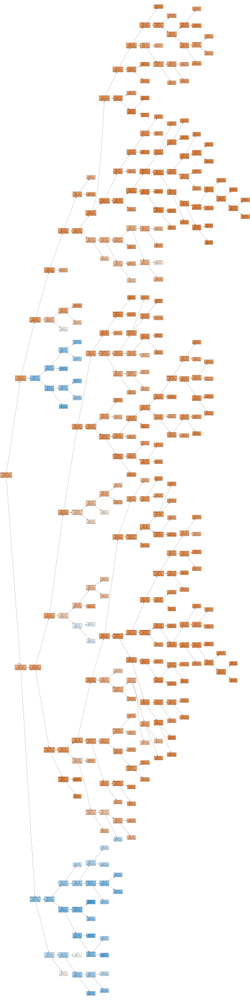

In [48]:
draw_tree(m.estimators_[0], X_train, precision=2)